# TRABAJO 1: ENSEMBLE LEARNING | MACHINE LEARNING II
## Feb 2023
--- 

### GRUPO: G3
- Enrique Gil García
- Blanca Gómez Pérez
- María José Medina Hernández
- An Rotella Fernández
- Marta Simón Pinacho

--- 

**IMPORTANTE:**
- Asegúrate, fijando la semilla de los nº aleatorios según proceda, que si se vuelve a ejecutar el cuaderno los resultados son idénticos
- Responde a las preguntas planteadas utilizando instrucciones "print" que permitan leer cómodamente como resultado de la ejecución de la celda el texto explicativo junto a las figuras o tablas a las que haga referencia (mira el ejemplo en la primera gráfica que se representa). También puedes usar markdown para responder.
- No escribas líneas de código muy largas, tienes una regla para ayudarte a no hacerlo
- No cambies la estructura del documento, respeta las secciones que ya existen


---
Importamos todos los paquetes aquí por comodidad

In [35]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.pipeline import Pipeline
from sklearn.ensemble import BaggingClassifier
from sklearn.tree import DecisionTreeClassifier, plot_tree, export_text
from mltools import model_tools as MT
from sklearn import metrics
from sklearn.metrics import ConfusionMatrixDisplay, confusion_matrix
from mltools import classification_tools as CT
from sklearn.inspection import permutation_importance

from sklearn.preprocessing import StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.decomposition import PCA
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
import math

from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from imblearn.pipeline import make_pipeline as imbalanced_make_pipeline
from imblearn.over_sampling import SMOTE

import warnings
warnings.filterwarnings("ignore")

### 1. AJUSTE DE LOS MODELOS CON EL DATASET AJU_DATOS_DEM_C3

Se trata de estimar la variable FESTIVO (1: el día es festivo) a partir de las variables disponibles en el dataset que se consideren oportunas. NO se pueden utilizar como variables de entrada: FECHA, DIA ni ANNO. La FECHA es interesante manejarla simplemente como ayuda para entender lo que esté pasando.

Se deben ajustar diferentes modelos, buscando un buen compromiso entre la complejidad y el error en cada uno de ellos. El objetivo es conseguir un buen modelo con una gran capacidad de acierto en el futuro. Modelos que deben crearse, analizando los resultados de cada uno de ellos (errores e importancias de las variables):
- Simple tree
- Bagged  tree
- Random Forest
- Gradient boosting
- Stacking

Carga de datos

In [2]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|

def read_data():
    df_aju = pd.read_csv('AJU_DATOS_DEM_C3.csv')

    # parseamos la fecha (cadena) para que sea un datetime con formato dd/mm/yyyy 
    # esta variable NO se puede utilizar como entrada en los modelos
    df_aju.FECHA = pd.to_datetime(df_aju.FECHA, format='%d/%m/%Y') 
    s=df_aju.loc[:,'FECHA']
    df_aju['FECHA'] =  s.dt.date

    # eliminamos las variables que no se pueden usar como entradas en los modelos
    del df_aju['ANNO']
    del df_aju['DIA']
    return df_aju

df_aju = read_data()

print('Tamaño de df_orig con los datos cargados:', df_aju.shape)
print('Dataframe con todos los datos leidos (filas: días, columnas: variables):')
df_aju

Tamaño de df_orig con los datos cargados: (2879, 30)
Dataframe con todos los datos leidos (filas: días, columnas: variables):


,FECHA,CR00,CR01,CR02,CR03,CR04,CR05,CR06,CR07,CR08,...,CR19,CR20,CR21,CR22,CR23,MES,DIASEM,FESTIVO,TMIN,TMAX
0,2014-01-01,0.040942,0.038985,0.036382,0.034416,0.033409,0.033420,0.034054,0.034229,0.035889,...,0.055197,0.054185,0.051063,0.046240,0.041000,1,3,1,12.3,20.2
1,2014-01-02,0.033950,0.030996,0.029517,0.028966,0.029165,0.030150,0.032944,0.036510,0.041196,...,0.055820,0.054451,0.051482,0.046145,0.040880,1,4,0,12.0,20.1
2,2014-01-03,0.035463,0.032112,0.030292,0.029521,0.029450,0.030515,0.033188,0.036656,0.041052,...,0.055230,0.053520,0.050286,0.045412,0.040025,1,5,0,13.2,21.0
3,2014-01-04,0.035959,0.032772,0.031034,0.030178,0.030135,0.030782,0.032598,0.034982,0.039299,...,0.053757,0.052620,0.049973,0.044970,0.040386,1,6,0,14.4,23.4
4,2014-01-05,0.037506,0.034148,0.031878,0.031126,0.030930,0.031604,0.033066,0.034803,0.038758,...,0.052902,0.051481,0.049655,0.045730,0.040905,1,7,0,12.8,23.1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2874,2021-12-27,0.033180,0.031299,0.030173,0.029493,0.029649,0.030814,0.033925,0.037837,0.042098,...,0.051685,0.050563,0.047267,0.042237,0.037797,12,1,0,16.1,23.0
2875,2021-12-28,0.033823,0.031731,0.030385,0.029950,0.030017,0.031203,0.034708,0.038432,0.042645,...,0.051867,0.050971,0.047718,0.042585,0.037774,12,2,0,16.6,22.7
2876,2021-12-29,0.034475,0.032198,0.030902,0.030441,0.030384,0.031487,0.034454,0.038381,0.042850,...,0.052136,0.050604,0.046788,0.042033,0.037595,12,3,0,14.3,21.3
2877,2021-12-30,0.034345,0.031919,0.030524,0.029991,0.030087,0.031286,0.034384,0.038574,0.042778,...,0.052092,0.050993,0.047587,0.042807,0.038252,12,4,0,13.4,26.4


Visión general de las series

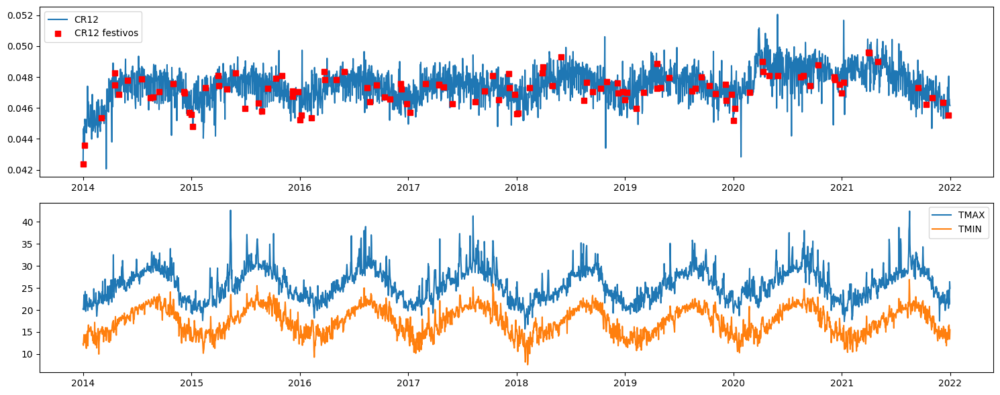

Se observa que el nº de festivos (115) es claramente inferior al nº de laborables (2764)
En concreto, el porcentaje de festivos en el conjunto de ajuste es 3.99444251476207 %


In [3]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|
fig = plt.figure(1, figsize=(15,6))
ax1 = plt.subplot(2,1,1)

ind_festivo = df_aju.FESTIVO == 1

plt.plot(df_aju.FECHA, df_aju.CR12, label='CR12')

plt.plot(df_aju.FECHA[ind_festivo], df_aju.CR12[ind_festivo], 'sr', label='CR12 festivos')
plt.legend()

plt.subplot(2,1,2,sharex= ax1)
plt.plot(df_aju.FECHA, df_aju.TMAX, label='TMAX')
plt.plot(df_aju.FECHA, df_aju.TMIN, label='TMIN')
plt.tight_layout()
plt.legend()

plt.show()

num_festivos = np.count_nonzero(df_aju.FESTIVO)
num_laborables = df_aju.shape[0] - num_festivos
print(f'Se observa que el nº de festivos ({num_festivos}) es claramente inferior al nº de laborables ({num_laborables})')
print(f'En concreto, el porcentaje de festivos en el conjunto de ajuste es {100*num_festivos /  df_aju.shape[0]} %')
# fig.savefig('figura1.pdf')

---
### 1.1 Análisis exploratorio básico del problema

- Incluye un análisis que te permita comprender la naturaleza del problema, cómo son las variables de entrada, su interrelación, así como su relación con la variable de salida
- Comenta todo lo que parezca relevante para el tema tratado, incluyendo todas las gráficas que consideres oportunas
- Estudia cómo se reparten los festivos según el día de la semana y los meses

In [4]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|
#Primero convertimos la variable de salida en category
df_aju['FESTIVO'] = df_aju['FESTIVO'].astype('category')

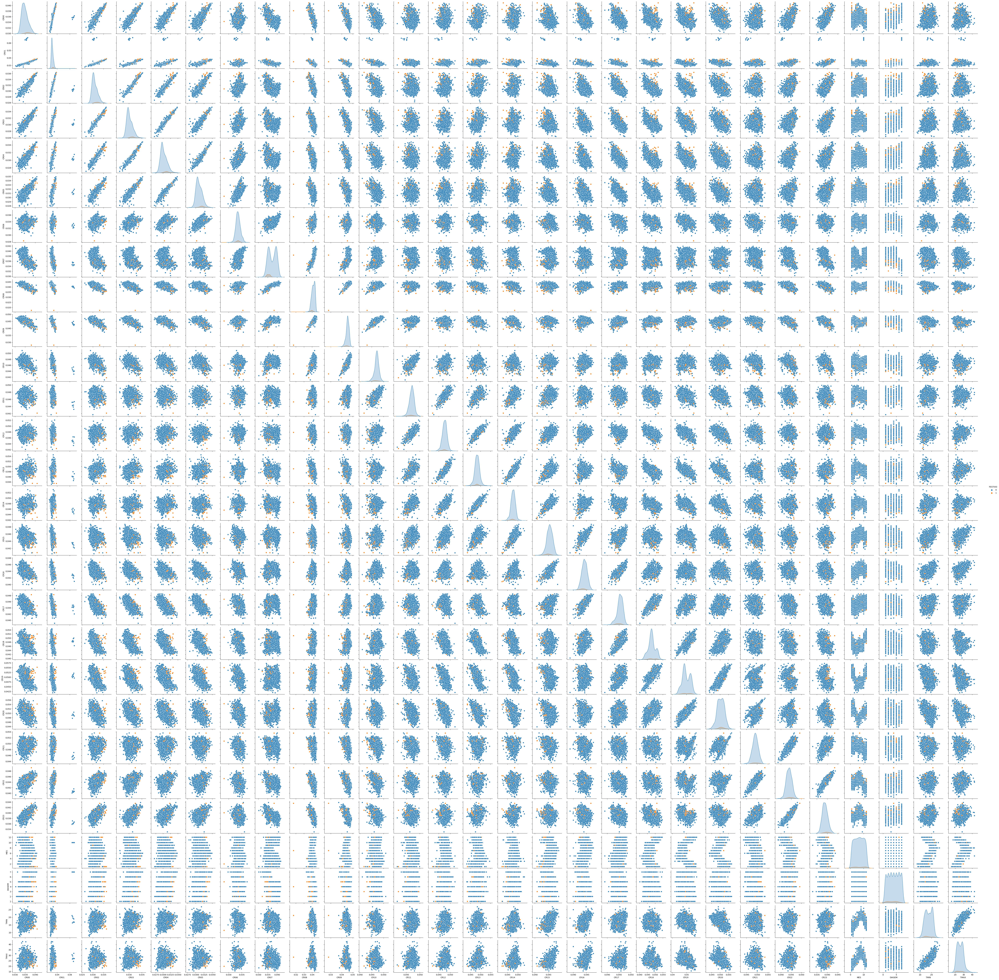

In [5]:
sns.pairplot(df_aju, hue="FESTIVO")

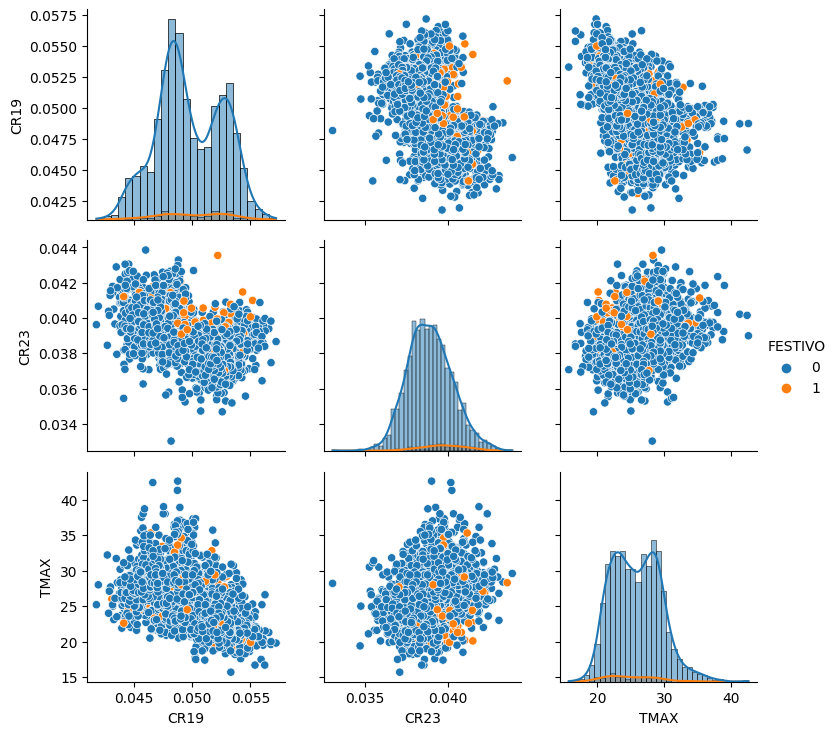

In [6]:
# Focus on interesting variables
g = sns.PairGrid(df_aju, vars=["CR19", "CR23","TMAX"], hue="FESTIVO")
g.map_diag(sns.histplot, kde=True)
g.map_offdiag(sns.scatterplot)
g.add_legend()

Al tener clases tan desbalanceadas se hace un poco dificil apreciar qué variable podria clasificar mejor a simple vista, ya que la mayoria de puntos que vemos en el scatter plot son azules, que son los dias que no son festivos. Además, como ya mencionaremos mas adelante, no hay ninguna variable que tenga una relacion alta con la variable de salida. 

Al ser un problema de clasificación y al tener tener tantas variables, hemos hecho graficas sólamente de aquellas tres variables que sospechamos que pueden separar los dos tipos de clase (festivo y no festivo), esas son CR19,CR23 y TMAX.

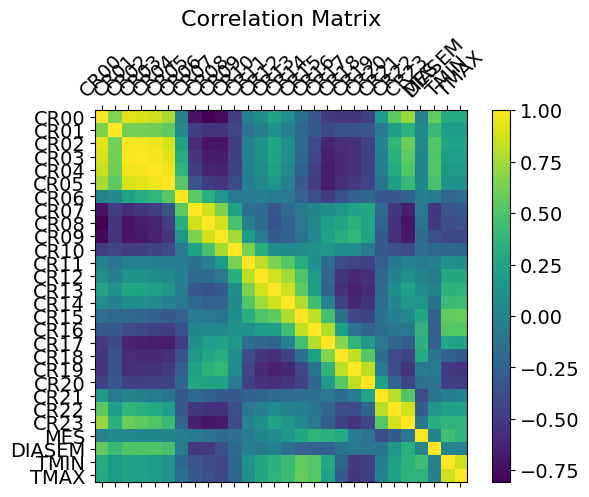

In [7]:
### Exploratory analysis -------------------------------------------------------------------------------------
#correlation plot of numeric variables
f = plt.figure()
plt.matshow(df_aju.select_dtypes(include=['int64','float64']).corr(), fignum=f.number)
plt.xticks(range(df_aju.select_dtypes(include=['int64','float64']).shape[1]), df_aju.select_dtypes(include=['int64','float64']).columns, fontsize=14, rotation=45)
plt.yticks(range(df_aju.select_dtypes(include=['int64','float64']).shape[1]), df_aju.select_dtypes(include=['int64','float64']).columns, fontsize=14)
cb = plt.colorbar()
cb.ax.tick_params(labelsize=14)
plt.title('Correlation Matrix', fontsize=16)
plt.show()

In [8]:
df_aju.corr()

,CR00,CR01,CR02,CR03,CR04,CR05,CR06,CR07,CR08,CR09,...,CR18,CR19,CR20,CR21,CR22,CR23,MES,DIASEM,TMIN,TMAX
CR00,1.000000,0.649143,0.924715,0.892032,0.860473,0.767746,0.004409,-0.721845,-0.806965,-0.759511,...,-0.516594,-0.535506,-0.452476,0.166705,0.541708,0.722006,-0.005375,0.568827,0.310718,0.297573
CR01,0.649143,1.000000,0.624885,0.615096,0.605932,0.553999,0.044173,-0.470424,-0.529553,-0.536335,...,-0.349983,-0.349859,-0.324765,-0.055107,0.195872,0.347357,0.054423,0.414960,0.198179,0.205916
CR02,0.924715,0.624885,1.000000,0.979619,0.955395,0.887785,0.235442,-0.573455,-0.713695,-0.712224,...,-0.578024,-0.561563,-0.464948,0.014528,0.376458,0.594505,0.026376,0.516022,0.255317,0.252257
CR03,0.892032,0.615096,0.979619,1.000000,0.978747,0.920995,0.310423,-0.520807,-0.667190,-0.677042,...,-0.593601,-0.563694,-0.464139,-0.015224,0.337686,0.555233,0.025375,0.504434,0.222252,0.223928
CR04,0.860473,0.605932,0.955395,0.978747,1.000000,0.954225,0.374179,-0.474611,-0.616910,-0.631394,...,-0.582644,-0.543472,-0.454088,-0.039213,0.300114,0.512880,0.017059,0.508255,0.178878,0.184403
CR05,0.767746,0.553999,0.887785,0.920995,0.954225,1.000000,0.524099,-0.345934,-0.495345,-0.527366,...,-0.553492,-0.507898,-0.434821,-0.101760,0.206940,0.408313,0.021452,0.470761,0.113313,0.122762
CR06,0.004409,0.044173,0.235442,0.310423,0.374179,0.524099,1.000000,0.546517,0.334508,0.134935,...,-0.349632,-0.250586,-0.195737,-0.309131,-0.298799,-0.226559,-0.027390,-0.069316,-0.197738,-0.156116
CR07,-0.721845,-0.470424,-0.573455,-0.520807,-0.474611,-0.345934,0.546517,1.000000,0.868325,0.641257,...,0.148874,0.237888,0.282117,-0.191226,-0.513312,-0.649214,-0.068658,-0.518938,-0.330253,-0.300040
CR08,-0.806965,-0.529553,-0.713695,-0.667190,-0.616910,-0.495345,0.334508,0.868325,1.000000,0.876163,...,0.275925,0.351540,0.258847,-0.234825,-0.540730,-0.694788,-0.121456,-0.499927,-0.382115,-0.357476
CR09,-0.759511,-0.536335,-0.712224,-0.677042,-0.631394,-0.527366,0.134935,0.641257,0.876163,1.000000,...,0.315482,0.387928,0.247627,-0.296883,-0.550756,-0.674168,-0.165874,-0.355954,-0.425298,-0.419720


Aqui estamos estudiando la relación que tienen las variables, unas con otras, ademas de con la salida. Algunos puntos interesantes a destacar son:

- Hay varias variables de entrada que están bastante correlacionadas entre ellas, como por ejemplo CR00 y CR02 con una correlacion de 0.979. Esto quiere decir que una puede explicar a la otra y que, a la hora de hacer nuestro modelo, podemos llegar a descartar una de ellas como input ya que la otra nos estaría aportando la misma información. Otros ejemplos de correlaciones altas son CR03 y CR04 o CR02 y CR00. Por otro lado, tambien hemos encontrado variables que estaban alta pero inversamente correlacionadas como CR00 y CR08 con una correlacion igual a -0.806.

- La interpretación que podemos sacar de la confusion matrix es que las variables que están muy correlacionadas son aquellas horas que están muy seguidas entre ellas, esto se debe a que es muy probable que lo que se esté haciendo a las 3 de la mañana también se esté haciendo a las 4, como por ejemplo, dormir. Sin embargo, si nos fijamos en la correlacion altamente negativa que hemos comentado antes entre CR00 y CR12, puede deberse a que, a las 02 una persona en general suele estar durmiendo y, a las 08, levantándose para ir a trabajar.

#### Prepara los conjuntos de entrenamiento y test

- Divide los datos disponibles de ajuste (df_aju) en dos conjuntos diferentes (TR:80% y TS: 20%). TS lo deberías de utilizar para validar la calidad de los diferentes modelos que se creen.
- Recuerda fijar una semilla para garantizar que la separación es reproducible

In [9]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|
# Crea dos dataframes df_aju_tr y df_aju_ts y trabaja con ellos

def split_dataset():
    
    # Define input and output matrices
    INPUTS = df_aju.columns[~df_aju.columns.isin(['FESTIVO', 'FECHA'])]
    OUTPUT = 'FESTIVO'
    X = df_aju[INPUTS]
    y = df_aju[OUTPUT]

    # Split
    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.2,  #percentage of test data
                                                        random_state=0, #seed for replication
                                                        stratify = y)   #Preserves distribution of y
    return INPUTS, OUTPUT, X_train, X_test, y_train, y_test

INPUTS, OUTPUT, X_train, X_test, y_train, y_test = split_dataset()
# # Crea dos dataframes df_aju_tr y df_aju_ts y trabaja con ellos
# df_aju_tr = X_train.copy()
# df_aju_tr['FESTIVO'] = y_train # We will call Y as output variable for simplicity
# df_aju_ts = X_test.copy()
# df_aju_ts['FESTIVO'] = y_test # We will call Y as output variable for simplicity>

#### 1.2. Ajusta un modelo de clasificación sencillo que sea robusto y que pueda servir de referencia de comparación con otros modelos más complejos.

- Optimiza la complejidad
- Revisa los errores en TR y TS, la matrices de confusión, y verifica la capacidad de generación
- Analiza la lógica que emplea para determinar si es festivo
- Revisa la importancia de las variables

In [10]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|
## Inputs of the model. Change accordingly to perform variable selection
INPUTS_DT = INPUTS

# Cuanto mas grande sea el min_impurity_decrease, mas sencillo va a ser mi árbol (es un hyperparameter)
param = {'DT__min_impurity_decrease': np.arange(0,0.05,0.005)} # Minimum entropy to decrease in each split
pipe = Pipeline(steps=[('scaler', StandardScaler()), 
                       ('DT', DecisionTreeClassifier(criterion='gini',  # impuriry measure - también se puede utilizar "entropy"
                                                     min_samples_split=5, # Minimum number of obs in node to keep cutting
                                                     min_samples_leaf=5, # Minimum number of obs in a terminal node
                                                     random_state=150))]) # For replication

# We use Grid Search Cross Validation to find the best parameter for the model in the grid defined 
nFolds = 10
tree_fit = GridSearchCV(estimator=pipe, # Structure of the model to use
                       param_grid=param, # Defined grid to search in
                       n_jobs=-1, # Number of cores to use (parallelize)
                       scoring='accuracy', # Accuracy https://scikit-learn.org/stable/modules/model_evaluation.html
                       cv=nFolds) # Number of Folds 
tree_fit.fit(X_train[INPUTS_DT], y_train) # Search in grid

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('DT',
                                        DecisionTreeClassifier(min_samples_leaf=5,
                                                               min_samples_split=5,
                                                               random_state=150))]),
             n_jobs=-1,
             param_grid={'DT__min_impurity_decrease': array([0.   , 0.005, 0.01 , 0.015, 0.02 , 0.025, 0.03 , 0.035, 0.04 ,
       0.045])},
             scoring='accuracy')

In [11]:
# Show the best grid parameter combination found by CV
tree_fit.best_estimator_['DT'].get_params()

{'ccp_alpha': 0.0,
 'class_weight': None,
 'criterion': 'gini',
 'max_depth': None,
 'max_features': None,
 'max_leaf_nodes': None,
 'min_impurity_decrease': 0.0,
 'min_samples_leaf': 5,
 'min_samples_split': 5,
 'min_weight_fraction_leaf': 0.0,
 'random_state': 150,
 'splitter': 'best'}

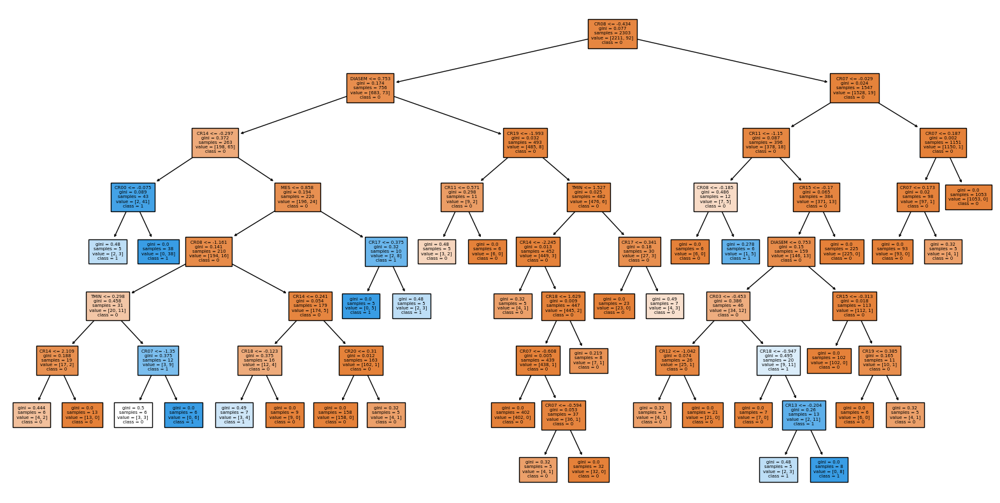

In [12]:
## Plot the decision tree model (use figsize and fontsize for getting the best view)
plt.figure(figsize=(20, 10))
plot_tree(tree_fit.best_estimator_['DT'], # Utiliza los parámetros óptimos obtenidos de la búsqueda de la cuadrícula
          feature_names= INPUTS_DT, # Lista de variables utilizadas en el modelo
          class_names= [str(s) for s in y_train.unique()], # Lista de nombres de las clases objetivo en el modelo
          fontsize=5, # Tamaño de fuente utilizado en la visualización del árbol
          filled=True) # Las cajas del árbol se colorearán según la mayoría de la clase objetivo
plt.show()

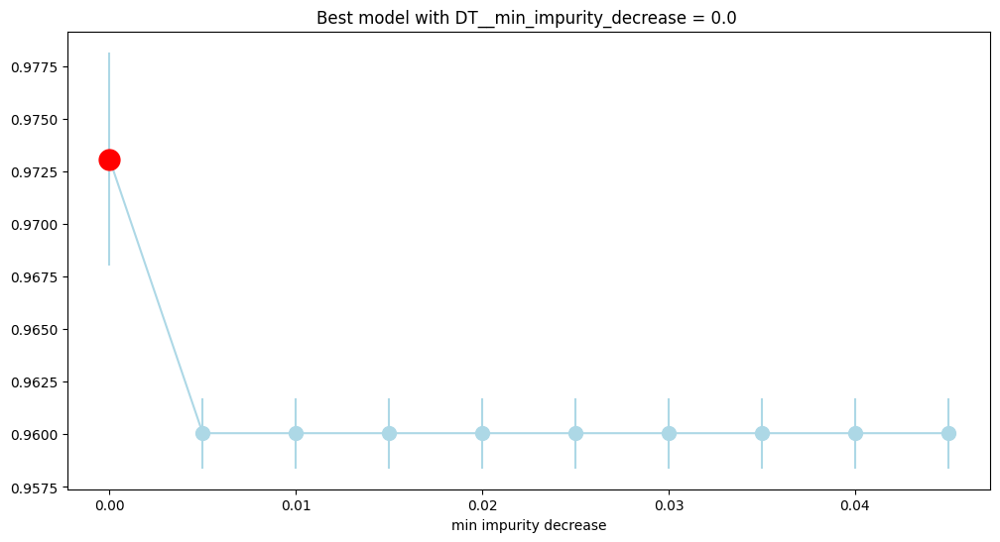

In [13]:
MT.plotModelGridError(tree_fit)

El valor mas optimo del parametro min_impurity_decrease es igual a 0, lo que significa que se permiten todas las divisiones que reducen la impureza, incluso si la reducción es muy pequeña. Al establecer un valor mínimo de min_impurity_decrease, podemos limitar el crecimiento del árbol y evitar el sobreajuste.El valor mas optimo del parametro min_impurity_decrease es igual a 0 

In [14]:
clf = tree_fit.best_estimator_['DT']
y_train_pred = clf.predict(X_train[INPUTS_DT]).tolist()
y_test_pred = clf.predict(X_test[INPUTS_DT]).tolist()

# main metrics
# Se calcula la precisión y la precisión equilibrada
acc_tr = metrics.accuracy_score(y_train,y_train_pred)
acc_ts = metrics.accuracy_score(y_test,y_test_pred)

acc_bal_tr = metrics.balanced_accuracy_score(y_train,y_train_pred)
acc_bal_ts = metrics.balanced_accuracy_score(y_test,y_test_pred)

dfacc =  pd.DataFrame([[acc_tr, acc_ts], [acc_bal_tr, acc_bal_ts]], index= ['Accuracy', 'Balanced accuracy'],  columns=['TR', 'TS'])
print(dfacc)

# Se crean las confusion matrixs
print('\nMETRICS TRAINING:')
CT.confusion_matrix(y_train, y_train_pred, labels=[1, 0])
print('\nMETRICS TEST SET:')
CT.confusion_matrix(y_test, y_test_pred, labels=[1, 0])

                         TR        TS
Accuracy           0.960052  0.960069
Balanced accuracy  0.500000  0.500000

METRICS TRAINING:
Confusion Matrix and Statistics
	   Prediction
 Reference  1    0
         1  0   92
         0  0 2211

Accuracy: 0.96
No Information Rate: 0.96
P-Value [Acc > NIR]: 0.53
Kappa: 0.0
Mcnemar's Test P-Value: 0.0
Sensitivity: 1.0
Specificity: 0.0
Precision: 0.0
Recall: 0.0
Prevalence: 0.96
Detection Rate: 0.96
Detection prevalence: 1.0
Balanced accuracy: 0.5
F1 Score: 0.0
Positive label: 1

METRICS TEST SET:
Confusion Matrix and Statistics
	   Prediction
 Reference  1   0
         1  0  23
         0  0 553

Accuracy: 0.96
No Information Rate: 0.96
P-Value [Acc > NIR]: 0.56
Kappa: 0.0
Mcnemar's Test P-Value: 0.0
Sensitivity: 1.0
Specificity: 0.0
Precision: 0.0
Recall: 0.0
Prevalence: 0.96
Detection Rate: 0.96
Detection prevalence: 1.0
Balanced accuracy: 0.5
F1 Score: 0.0
Positive label: 1


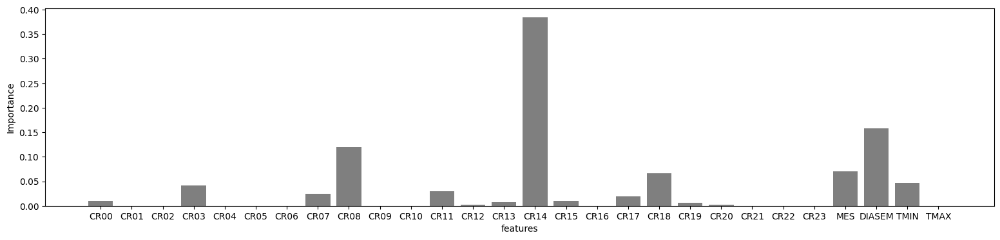

In [15]:
## Plot the variable importance of each feature
plt.figure(figsize=(19, 4))
bar_width = 0.35
plt.bar(INPUTS_DT, tree_fit.best_estimator_['DT'].feature_importances_, color='black', alpha=0.5)
plt.xlabel('features')
plt.ylabel('Importance')
plt.show()

Una vez realizado nuestro primer arbol podemos indicar los siguientes puntos:
- Este primer modelo no es un modelo muy bueno ya que aunque tengamos una accuracy de 0.96 tanto en trainning como en test esto se debe a tener clases tan desbalanceadas. Si nos fijamos en la confusion matrix, el modelo no es capaz de encontrar ni un solo dia que sea festivo, no ha sido capaz de distinguir bien. En este tipo de casos, es más correcto fijarse en el balanced accuracy que es de 0.5 que significa que al final la clasificación la está haciendo casi de manera aleatoria.
- Por otro lado el sensitivity mide la capacidad del modelo para identificar correctamente todos los casos positivos, que en este caso son los dias no festivos y por eso el sensitivity es igual a 1, porque los identifica todos. Por el contrario, la especificidad mide la capacidad del modelo para identificar correctamente todos los casos negativos y en este caso tiene sentido que sea igual a 0 ya que no está identificando los dias festivos. Otro punto que refuerza que nuestro modelo no tiene buen rendimiento es que el F1 Score es igual a 0

- Podriamos decir que la variable mas importante en este modelo es CR14 con una gran diferencia con respecto las demas y despues les siguen DIASEM, CR08 y MES

La capacidad de generación de un árbol de decisión se puede verificar mediante la evaluación del rendimiento del modelo en un conjunto de prueba que no se utilizó durante el entrenamiento. Hemos repetido este procedimiento varias veces para ver si podriamos mejorar el arbol y con el min_impurity_decrease igual a 0 hemos llegado al mas optimo pero podriamos llegar a mejorarlo si quitamos alguna varaible de entrada pero la mejora no seria muy grande ya que el arbol es capaz de distinguir que variables son las mas importantes para hacer las predicciones.

In [16]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|
## Inputs of the model. Change accordingly to perform variable selection
INPUTS_DT = INPUTS

# Cuanto mas grande sea el min_impurity_decrease, mas sencillo va a ser mi árbol (es un hyperparameter)
param = {'DT__min_impurity_decrease': np.arange(0,0.05,0.005)} # Minimum entropy to decrease in each split
pipe = Pipeline(steps=[('scaler', StandardScaler()), 
                       ('DT', DecisionTreeClassifier(criterion='gini',  # impuriry measure - también se puede utilizar "entropy"
                                                     min_samples_split=5, # Minimum number of obs in node to keep cutting
                                                     min_samples_leaf=5, # Minimum number of obs in a terminal node
                                                     random_state=150))]) # For replication

# We use Grid Search Cross Validation to find the best parameter for the model in the grid defined 
nFolds = 10
tree2_fit = GridSearchCV(estimator=pipe, # Structure of the model to use
                       param_grid=param, # Defined grid to search in
                       n_jobs=-1, # Number of cores to use (parallelize)
                       scoring='f1', # Accuracy https://scikit-learn.org/stable/modules/model_evaluation.html
                       cv=nFolds) # Number of Folds 
tree2_fit.fit(X_train[INPUTS_DT], y_train) # Search in grid

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('DT',
                                        DecisionTreeClassifier(min_samples_leaf=5,
                                                               min_samples_split=5,
                                                               random_state=150))]),
             n_jobs=-1,
             param_grid={'DT__min_impurity_decrease': array([0.   , 0.005, 0.01 , 0.015, 0.02 , 0.025, 0.03 , 0.035, 0.04 ,
       0.045])},
             scoring='f1')

In [17]:
clf = tree2_fit.best_estimator_['DT']
y_train_pred2 = clf.predict(X_train[INPUTS_DT]).tolist()
y_test_pred2= clf.predict(X_test[INPUTS_DT]).tolist()

# main metrics
# Se calcula la precisión y la precisión equilibrada
acc_tr2 = metrics.accuracy_score(y_train,y_train_pred2)
acc_ts2 = metrics.accuracy_score(y_test,y_test_pred2)

acc_bal_tr2 = metrics.balanced_accuracy_score(y_train,y_train_pred2)
acc_bal_ts2 = metrics.balanced_accuracy_score(y_test,y_test_pred2)

dfacc =  pd.DataFrame([[acc_tr2, acc_ts2], [acc_bal_tr2, acc_bal_ts2]], index= ['Accuracy', 'Balanced accuracy'],  columns=['TR', 'TS'])
print(dfacc)

# Se crean las confusion matrixs
print('\nMETRICS TRAINING:')
CT.confusion_matrix(y_train, y_train_pred2, labels=[1, 0])
print('\nMETRICS TEST SET:')
CT.confusion_matrix(y_test, y_test_pred2, labels=[1, 0])

                         TR        TS
Accuracy           0.960052  0.960069
Balanced accuracy  0.500000  0.500000

METRICS TRAINING:
Confusion Matrix and Statistics
	   Prediction
 Reference  1    0
         1  0   92
         0  0 2211

Accuracy: 0.96
No Information Rate: 0.96
P-Value [Acc > NIR]: 0.53
Kappa: 0.0
Mcnemar's Test P-Value: 0.0
Sensitivity: 1.0
Specificity: 0.0
Precision: 0.0
Recall: 0.0
Prevalence: 0.96
Detection Rate: 0.96
Detection prevalence: 1.0
Balanced accuracy: 0.5
F1 Score: 0.0
Positive label: 1

METRICS TEST SET:
Confusion Matrix and Statistics
	   Prediction
 Reference  1   0
         1  0  23
         0  0 553

Accuracy: 0.96
No Information Rate: 0.96
P-Value [Acc > NIR]: 0.56
Kappa: 0.0
Mcnemar's Test P-Value: 0.0
Sensitivity: 1.0
Specificity: 0.0
Precision: 0.0
Recall: 0.0
Prevalence: 0.96
Detection Rate: 0.96
Detection prevalence: 1.0
Balanced accuracy: 0.5
F1 Score: 0.0
Positive label: 1


Aqui hemos probado a poner en el scoring del gridsearch "fi" ya que tiene más sentido por lo que hemos explicado anteriormente pero el resultado sigue siendo el mismo

In [18]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|


#### 1.3. Ajusta un bagged tree para resolver el problema planteado.

- Optimiza la complejidad
- Revisa los errores en TR y TS, la matrices de confusión, y verifica la capacidad de generación
- Revisa la importancia de las variables

In [19]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|


#### 1.4. Ajusta un random forest para resolver el problema planteado.

- Optimiza la complejidad
- Revisa los errores en TR y TS, la matrices de confusión, y verifica la capacidad de generación
- Revisa la importancia de las variables

In [20]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|
# find optim nº of trees in the ensemble and max_features
param = {'RF__max_features': range(1, 6, 1), # Number number of features to consider when looking for the best split
         'RF__n_estimators': range(20, 150, 5)} # Number of trees in the forest

pipe =  Pipeline(steps=[('RF', 
                            RandomForestClassifier(
                                        criterion='gini',  # impurity measure
                                        min_samples_split=2, # Minimum number of obs in node to keep cutting
                                        min_samples_leaf=1, # Minimum number of obs in a terminal node  
                                        random_state=0)
                        )])

# We use Grid Search Cross Validation to find the best parameter for the model in the grid defined 
nFolds = 10
rf_fit = GridSearchCV(estimator=pipe, # Structure of the model to use
                       param_grid=param, # Defined grid to search in
                       n_jobs=-1, # Number of cores to use (parallelize)
                       scoring='accuracy', # Accuracy https://scikit-learn.org/stable/modules/model_evaluation.html
                       cv=nFolds) # Number of Folds 
# fit the bagged trees
INPUTS_RF = INPUTS  
rf_fit.fit(X_train[INPUTS_RF], y_train) # Search in grid

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('RF',
                                        RandomForestClassifier(random_state=0))]),
             n_jobs=-1,
             param_grid={'RF__max_features': range(1, 6),
                         'RF__n_estimators': range(20, 150, 5)},
             scoring='accuracy')

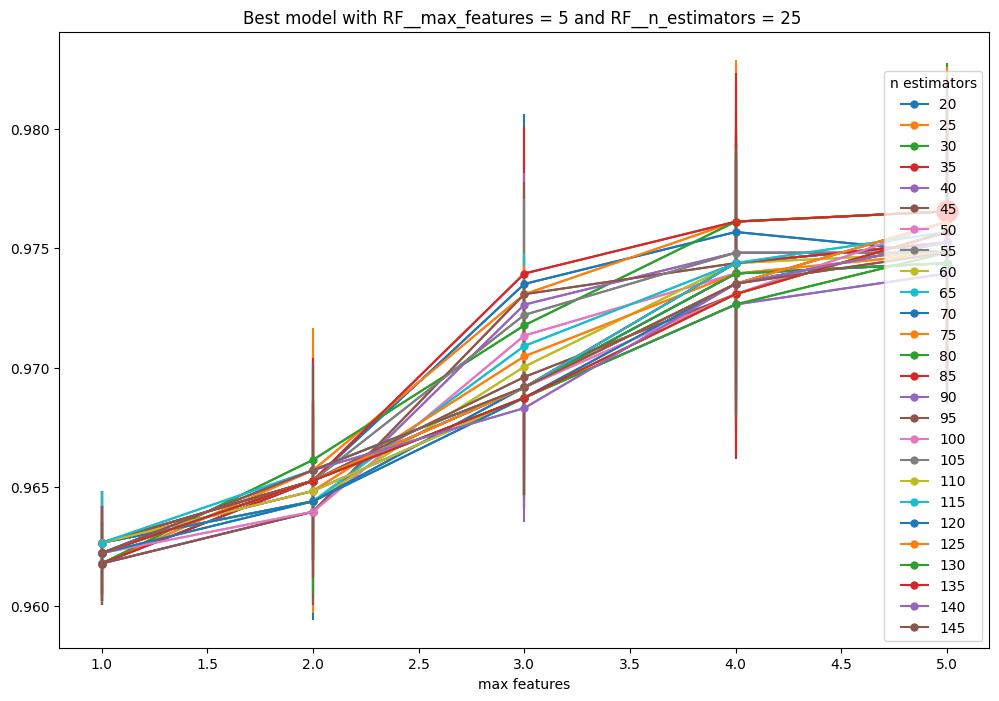

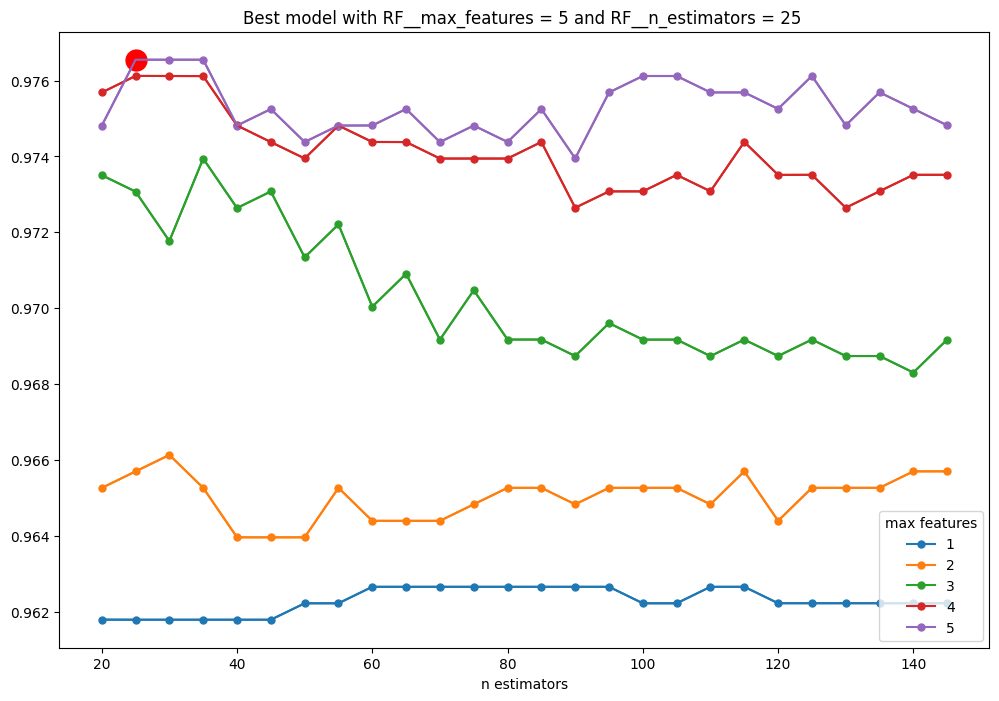

In [21]:
MT.plotModelGridError(rf_fit)

In [22]:
# Almacenamos en una variable el mejor modelo encontrado por GridSearchCV
RF_class_estim = rf_fit.best_estimator_['RF']

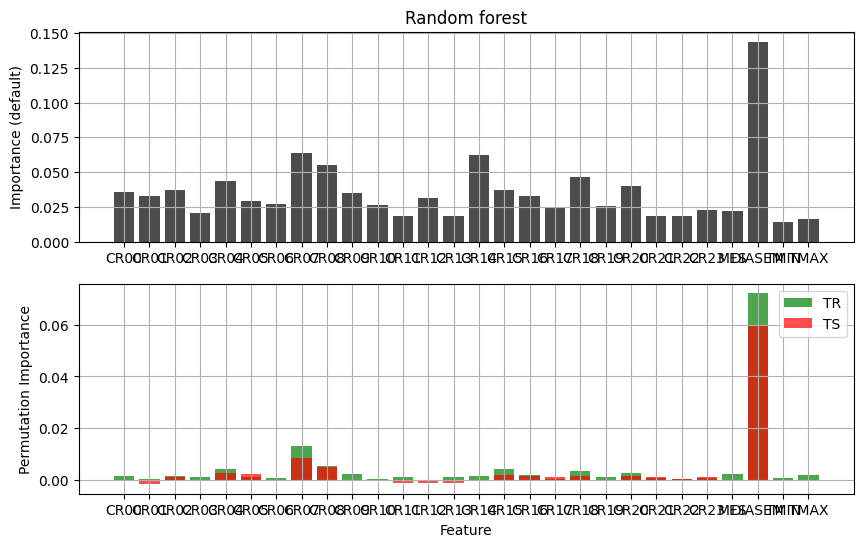

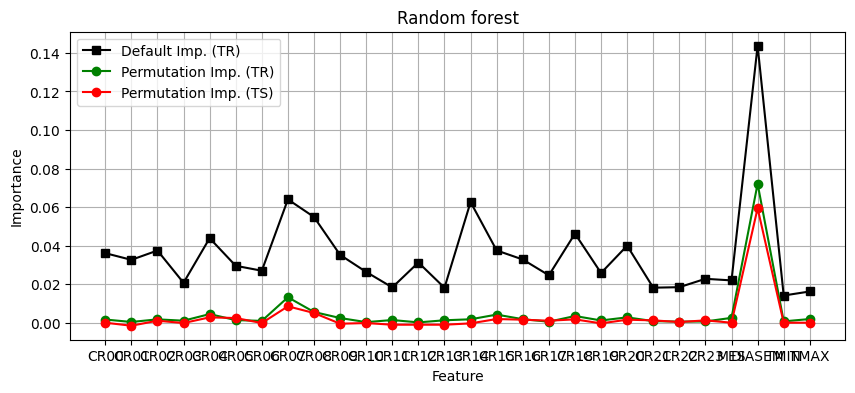

In [23]:
# Importancia de las variables de entrada en el modelo
## Feature importance evaluation using "Permutation Importance" (training and test)
importances_tr_RF_class_estim = permutation_importance(RF_class_estim, 
                                    X_train[INPUTS_RF], y_train,
                                    n_repeats=10,
                                    random_state=0)

importances_ts_RF_class_estim = permutation_importance(RF_class_estim, 
                                    X_test[INPUTS_RF], y_test,
                                    n_repeats=10,
                                    random_state=0)
 
## Plot importances

# Plot the variable importance of each feature given by feature_importances_ attribute
plt.figure(figsize=(10, 6))

plt.subplot(2,1,1)
plt.bar(INPUTS_RF, RF_class_estim.feature_importances_, color='black', alpha=0.7)
plt.ylabel('Importance (default)')
plt.title('Random forest')
plt.grid()

plt.subplot(2,1,2)
plt.bar(INPUTS_RF, importances_tr_RF_class_estim.importances_mean, color='green', alpha=0.7, label='TR')
plt.bar(INPUTS_RF, importances_ts_RF_class_estim.importances_mean, color='red', alpha=0.7, label='TS')
plt.xlabel('Feature')
plt.ylabel('Permutation Importance')
plt.legend()
plt.grid()
plt.show()

# Plot the variable importances of each feature (all together)
plt.figure(figsize=(10, 4))

plt.plot(INPUTS_RF, RF_class_estim.feature_importances_, 's-',  color='black', label='Default Imp. (TR)')
plt.plot(INPUTS_RF, importances_tr_RF_class_estim.importances_mean, 'o-', color='green', label='Permutation Imp. (TR)')
plt.plot(INPUTS_RF, importances_ts_RF_class_estim.importances_mean, 'o-', color='red', label='Permutation Imp. (TS)')
plt.xlabel('Feature')
plt.ylabel('Importance')
plt.title('Random forest')
plt.legend()
plt.grid()
plt.show()

In [24]:
# model predictions in training (TR) and test (TS) sets
clf = RF_class_estim
y_train_pred = clf.predict(X_train[INPUTS_RF]).tolist()
y_test_pred = clf.predict(X_test[INPUTS_RF]).tolist()

# main metrics
acc_tr = metrics.accuracy_score(y_train,y_train_pred)
acc_ts = metrics.accuracy_score(y_test,y_test_pred)

acc_bal_tr = metrics.balanced_accuracy_score(y_train,y_train_pred)
acc_bal_ts = metrics.balanced_accuracy_score(y_test,y_test_pred)

dfacc =  pd.DataFrame([[acc_tr, acc_ts], [acc_bal_tr, acc_bal_ts]], index= ['Accuracy', 'Balanced accuracy'],  columns=['TR', 'TS'])
print(dfacc)

print('\nMETRICS TRAINING:')
CT.confusion_matrix(y_train, y_train_pred, labels=[1, 0])
print('\nMETRICS TEST SET:')
CT.confusion_matrix(y_test, y_test_pred, labels=[1, 0])

                         TR        TS
Accuracy           0.999566  0.979167
Balanced accuracy  0.994565  0.759965

METRICS TRAINING:
Confusion Matrix and Statistics
	   Prediction
 Reference  1    0
         1 91    1
         0  0 2211

Accuracy: 1.0
No Information Rate: 0.92
P-Value [Acc > NIR]: 0.0
Kappa: 0.99
Mcnemar's Test P-Value: 1.0
Sensitivity: 1.0
Specificity: 0.99
Precision: 1.0
Recall: 0.99
Prevalence: 0.96
Detection Rate: 0.96
Detection prevalence: 0.96
Balanced accuracy: 0.99
F1 Score: 0.99
Positive label: 1

METRICS TEST SET:
Confusion Matrix and Statistics
	   Prediction
 Reference  1   0
         1 12  11
         0  1 552

Accuracy: 0.98
No Information Rate: 0.94
P-Value [Acc > NIR]: 0.01
Kappa: 0.66
Mcnemar's Test P-Value: 0.01
Sensitivity: 1.0
Specificity: 0.52
Precision: 0.92
Recall: 0.52
Prevalence: 0.96
Detection Rate: 0.96
Detection prevalence: 0.98
Balanced accuracy: 0.76
F1 Score: 0.67
Positive label: 1


#### 1.5. Ajusta un gradient boosting para resolver el problema planteado.

- Optimiza la complejidad
- Revisa los errores en TR y TS, la matrices de confusión, y verifica la capacidad de generación
- Revisa la importancia de las variables

A continuación se ha ajustado un modelo de Gradient Boosting para clasificar los días no festivos del dataset. En el código más adelante, tan solo se muestra el mejor modelo. Sin embargo, se probaron unos cuantos siguiendo la siguiente estrategia:

1. Primero se probó a realizar una optimización de los hiper-parámetros mediante el algoritmo de GridSearch, eligiendo el modelo con F1-score más alta. Los hiper-parámetros optimizados y los rangos utilizados fueron:

| Hiper parámetro   | Rango      | Valor óptimo |
|-------------------|------------|--------------|
| number_estimators | 100 - 500  | 300          |
| learning_rate     | 0.01 - 0.1 | 0.08         |
| max_depth         | 2-8        | 3            |
| max_features      | 3-6        | 5            |
| min_samples_split | 2-4        | 2            |
| min_samples_leaf  | 1-3        | 1            |

2. El modelo obtenido mediante GridSearch() presentaba un overfitting bastante alto, por lo que se decicidió simplificar el modelo mediante selección de variables y limitación del número de estimadores para que fuese capaz de generalizar mejor.

3. El modelo #2 obtenía un F1-score mejor que el #1. Sin embargo, el Recall era bastante bajo, por lo que se decidió utilizar una técnica de sobremuestreo llamada SMOTE para balancear el dataset.

4. El modelo de SMOTE es el que mejor generaliza obteniendo las mejores puntuaciones ante nuevas muestras.

A continuación se muestra el código empleado para el último modelo:

In [33]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|

df_aju = read_data()
INPUTS, OUTPUT, X_train, X_test, y_train, y_test = split_dataset()

In [43]:
number_estimators = 100
learning_rate = 0.08
max_depth = 3
min_impurity_decrease =  0.001 * np.var(y_train)

smote = SMOTE(random_state = 11)
X_train, y_train = smote.fit_resample(X_train, y_train)

pipe = Pipeline(steps=[('scaler', StandardScaler()),
                       ('GB', GradientBoostingClassifier(n_estimators=number_estimators,
                                            learning_rate = learning_rate,
                                            max_depth = max_depth,
                                            max_features = 1.0, # 'auto', ‘sqrt’, ‘log2’, int or float, default=None
                                            loss = 'log_loss',   # binomial and multinomial deviance
                                            min_samples_split=2, # Minimum number of obs in node to keep cutting
                                            min_samples_leaf=1, # Minimum number of obs in a terminal node  
                                            random_state=0))]) # For replication

INPUTS_BT = INPUTS
nFolds = 10
pipe.fit(X_train[INPUTS_BT], y_train) # Search in grid

Pipeline(steps=[('scaler', StandardScaler()),
                ('GB',
                 GradientBoostingClassifier(learning_rate=0.08,
                                            max_features=1.0,
                                            random_state=0))])

In [44]:
# model predictions in training (TR) and test (TS) sets
clf = pipe
y_train_pred = clf.predict(X_train[INPUTS_BT]).tolist()
y_test_pred = clf.predict(X_test[INPUTS_BT]).tolist()

# main metrics
acc_tr = metrics.accuracy_score(y_train,y_train_pred)
acc_ts = metrics.accuracy_score(y_test,y_test_pred)

acc_bal_tr = metrics.balanced_accuracy_score(y_train,y_train_pred)
acc_bal_ts = metrics.balanced_accuracy_score(y_test,y_test_pred)

dfacc =  pd.DataFrame([[acc_tr, acc_ts], [acc_bal_tr, acc_bal_ts]], index= ['Accuracy', 'Balanced accuracy'],  columns=['TR', 'TS'])
print(dfacc)

print('\nMETRICS TRAINING:')
CT.confusion_matrix(y_train, y_train_pred, labels=[1,0])
print('\nMETRICS TEST SET:')
CT.confusion_matrix(y_test, y_test_pred, labels=[1,0])

                         TR        TS
Accuracy           0.995929  0.982639
Balanced accuracy  0.995929  0.845114

METRICS TRAINING:
Confusion Matrix and Statistics
	   Prediction
 Reference    1    0
         1 2198   13
         0    5 2206

Accuracy: 1.0
No Information Rate: 0.5
P-Value [Acc > NIR]: 0.0
Kappa: 0.99
Mcnemar's Test P-Value: 0.1
Sensitivity: 1.0
Specificity: 0.99
Precision: 1.0
Recall: 0.99
Prevalence: 0.5
Detection Rate: 0.5
Detection prevalence: 0.5
Balanced accuracy: 1.0
F1 Score: 1.0
Positive label: 1

METRICS TEST SET:
Confusion Matrix and Statistics
	   Prediction
 Reference  1   0
         1 16   7
         0  3 550

Accuracy: 0.98
No Information Rate: 0.93
P-Value [Acc > NIR]: 0.0
Kappa: 0.75
Mcnemar's Test P-Value: 0.34
Sensitivity: 0.99
Specificity: 0.7
Precision: 0.84
Recall: 0.7
Prevalence: 0.96
Detection Rate: 0.95
Detection prevalence: 0.97
Balanced accuracy: 0.85
F1 Score: 0.76
Positive label: 1


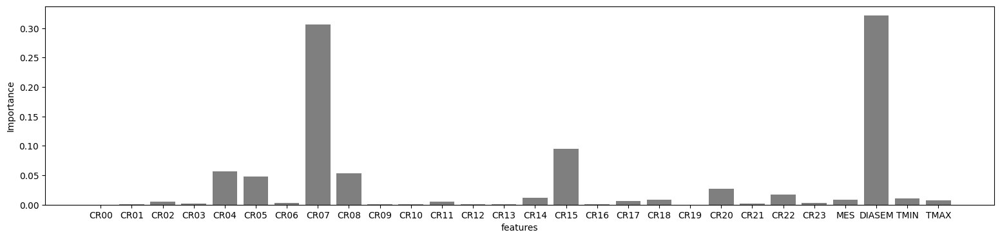

In [50]:
## Plot the variable importance of each feature
plt.figure(figsize=(19, 4))
bar_width = 0.35
plt.bar(INPUTS_BT, clf['GB'].feature_importances_, color='black', alpha=0.5)
plt.xlabel('features')
plt.ylabel('Importance')
plt.show()

En la celda anterior se muestra un gráfico de las variables más importantes para este modelo. Estas variables son:

1. Día de la semana
2. Consumo a las 07:00
3. Consumo a las 15:00
4. Consumo a las 04:00
5. Consumo a las 08:00
6. Consumo a las 05:00
7. Consumo a las 20:00

Las variables más importantes, son, por tanto, muy similares a las obtenidas en modelos anteriores. Esto es lógico ya que el modelo deberá primero comprobar si se trata de un día de diario o fin de semana (DIASEM), ya que los fines de semana se comportan de forma muy similar a los festivos. 

Una vez que se sabe que es entre semana, habrá mucha diferencia de consumo entre festivos y no festivos a las 7:00 y 8:00 de la mañana, cuando la gente se desprierta para ir a trabajar. Si es festivo la hora de despertarse se pospone. 

También habrá diferencia importante a las 15:00, ya que en España en un día festivo se hará a esta hora descanso para comer o para dormir la siesta, mientras que en un día de diario es necesario continuar trabajando.

Por último, un día festivo tendrá mayor actividad a las 04:00 y 05:00 de la mañana, ya que la gente saldrá de fiesta y continuará despierta hasta mucho más tarde.

A continuación se guarda el modelo para su uso más adelante.

In [42]:
import pickle
filename = "./models/gradient_boosting.pickle"
pickle.dump(pipe, open(filename, "wb"))

#### 1.6. Utiliza staking con tus mejores tres modelos para intentar mejorar la soluciones obtenidas.
- Revisa los errores en TR y TS, la matrices de confusión, y verifica la capacidad de generación

In [26]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|


#### 1.7. Crea un número de variables reducido que contengan la información recogida en las variables CR00 a CR23 y crea un árbol sencillo basado en estas variables.
- El conjunto de variables creado tienen que ser una combinación lineal de CR00, ..., CR23
- Optimiza la complejidad del árbol
- Revisa los errores en TR y TS, la matrices de confusión, y verifica la capacidad de generación
- Analiza la lógica que emplea para determinar si es festivo
- Revisa la importancia de las variables, explicando el significado físico de las variables más importantes
- Compara los errores en TR y TS y la lógica del modelo con el creado anteriormente en el apartado 1.2.


In [27]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|


#### 1.8 Compara todos los modelos creados en términos de complejidad, interpretabilidad y errores
- Discute el posible impacto que tiene en los modelos el que existan menos festivos que laborables
- Compara la complejidad en términos de nº de parámetros y estructura del modelo, variables utilizadas, importancia de las mismas
- Compara la capacidad de generalización de los modelos utilizando TS y las diferencias en las matrices de confusión
- Estudia la tasa de fallos de los modelos dependiendo del día de la semana
- Indica qué modelo o modelos son los más prometedores para poner en producción, justificando la selección

##### Desbalanceo
Cuando hablamos de datos desbalanceados, nos referimos a conjuntos de datos donde **una o varias clases tienen una cantidad significativamente menor de ejemplos que otras clases**. La representación en el dataset de días festivos es inferior al 4%, por lo que está **moderadamente desbalanceado (1-20%)** [1]. Esto causa que los modelos presenten una tendencia a clasificar todas las muestras como "no festivas", ya que de esta manera alcanzan una accuracy de aproximadamente 96%. Por lo tanto, es de extrema importancia **no utilizar la medida de accuracy** para evaluar los modelos. 

Para ello, destacan dos medidas: la **"balanced accuracy" y el "F1-score"**. La primera es una medida que tiene en cuenta el desbalanceo en las clases y es la media aritmética de las tasas de verdaderos positivos (TPR) y verdaderos negativos (TNR). La **Balanced Accuracy es adecuada cuando ambas clases tienen una importancia similar**, y cuando el objetivo es tener una tasa de clasificación correcta equilibrada entre ambas clases. Por otro lado, el F1-score combina tanto la precisión como el recall del modelo. Es adecuada cuando se desea equilibrar la importancia de la precisión y el recall. Esta medida es particularmente útil cuando el objetivo es **detectar correctamente los casos positivos** (la clase minoritaria en situaciones de desbalanceo), pero a costa de un mayor número de falsos positivos.

Para este trabajo, se ha elegido utilizar el **F1-score** ya que se ha considerado más útil identificar más días festivos, a costa de clasificar erróneamente un mayor número de "no festivos". Sin embargo, la balanced accuracy también podría ser una elección adecuada si para la aplicación fuese perjudicial obtener un número alto de falsos positivos. Por tanto, al tunear los hiperparámetros de los modelos, se han **elegido aquellos con un mayor F1-score**. Además, a la hora de evaluarlos, se compararán utilizando esta métrica. Por último, también se analizaran las puntuaciones de las medidad se Precision y Recall con el fin de entender en qué tipo de muestras se producen los fallos de los modelos.

Sin embargo, utilizar estas métricas puede no ser suficiente para obtener un buen resultado ya que al haber tan poca representación de la clase "Festivo", **es posible que no haya suficente información para que los modelos la aprendan**. Para compensarlo, se pueden utilizar técnicas de balanceo. En este contexto, el submuestreo y el sobremuestreo son técnicas utilizadas para abordar el desbalanceo en los datos.

El **submuestreo implica eliminar ejemplos de la clase mayoritaria** para equilibrar la distribución de clases. Sin embargo, esto puede llevar a la pérdida de información y disminuir la capacidad de generalización del modelo.

El **sobremuestreo, por otro lado, consiste en generar nuevos ejemplos de la clase minoritaria** para igualar su cantidad con la clase mayoritaria. Esta técnica puede aumentar el tamaño del conjunto de datos y permitir que el modelo aprenda más sobre la clase minoritaria, mejorando así la capacidad de generalización. Sin embargo, si se realiza de forma indiscriminada, puede llevar a la sobrecarga de información y al sobreajuste del modelo.

**SMOTE (Synthetic Minority Over-sampling Technique)** es una técnica de sobre-muestreo para conjuntos de datos desbalanceados. Esta técnica **genera nuevos datos sintéticos** de la clase minoritaria (la clase con menos ejemplos) mediante la **interpolación entre las instancias existentes**. Para ello, SMOTE selecciona aleatoriamente una instancia de la clase minoritaria y calcula los k vecinos más cercanos de esta instancia. A continuación, SMOTE elige aleatoriamente uno de estos vecinos y genera un nuevo punto sintético a lo largo del segmento que une la instancia seleccionada con su vecino seleccionado. Repitiendo este proceso para varias instancias de la clase minoritaria, SMOTE crea una nueva base de datos sintética que tiene un equilibrio más equitativo entre las clases. Esta técnica ha demostrado ser efectiva para mejorar el rendimiento de los algoritmos de aprendizaje automático en problemas de clasificación desbalanceados.

En este proyecto se ha utilizado la técnica de SMOTE en algunos algoritmos para mejorar su rendimiento. Es importante tener en cuenta que la técnica **se debe aplicar tan solo al conjunto de training**, nunca al de test o al de validación, ya que de hacerlo la evaluación se estaría realizando sobre un conjunto de datos sintético, que podría no ser representativo de la realidad.

##### Complejidad

Es importante conocer la complejidad de un modelo ya que esto puede afectar su **rendimiento y su capacidad para generalizar** correctamente. La complejidad puede medirse en términos de la complejidad temporal y espacial, así como la interpretabilidad del modelo.

- **Complejidad Espacial**: La complejidad espacial se refiere al espacio de memoria requerido para almacenar el modelo. Un modelo complejo puede requerir una gran cantidad de memoria, lo que puede ser un problema en sistemas con limitaciones de recursos. Por lo tanto, es importante evaluar la complejidad espacial junto con la complejidad temporal para garantizar que el modelo sea viable en términos de recursos. En este tipo de complejidad es clave el número de parámetros, el cual afecta de forma proporcional.

- **Complejidad Temporal**: La complejidad temporal se refiere al tiempo necesario para entrenar el modelo y hacer predicciones. Si un modelo es demasiado complejo, puede llevar mucho tiempo entrenar y predecir, lo que puede ser impráctico en situaciones donde se requiere una respuesta en tiempo real. Por lo tanto, es importante equilibrar la complejidad con la eficiencia temporal del modelo.

- **Interpretabilidad**: la interpretabilidad del modelo se refiere a la capacidad de entender cómo el modelo toma decisiones. Un modelo complejo puede ser difícil de interpretar, lo que puede ser un problema en situaciones donde es importante comprender la lógica detrás de las decisiones del modelo, como puede ser por ejemplo el ámbito médico. Por lo tanto, es importante evaluar la complejidad del modelo en términos de su interpretabilidad para garantizar que se pueda explicar adecuadamente cómo se tomaron las decisiones. En resumen, conocer la complejidad de un modelo es fundamental para garantizar su eficacia, eficiencia y comprensibilidad. A la hora de medir la interpretabilidad, es primordial tener en cuenta la estructura del modelo, las variables utilizadas y la importancia de las mismas.

Para calcular la complejidad espacial y la temporal, se han utilizado fórmulas aplicadas a cada algoritmo [2] [3], las cuales tienen en cuenta los siguientes parámetros:

- N = número de muestras
- d =dimensiones
- c = número de clases
- n = número de nodos
- k = número de árboles
- p = número de componentes principales

| Modelo                | Compl. Tiempo             | Compl. Espacio          | Interpretabilidad |
|-----------------------|---------------------------|-------------------------|-------------------|
| **Simple Tree**       | O(log(N))                 |  O(n)                   |  Alta             |
| **Bagged Tree**       | O(k log(N) )              |  O(n k)                 |  Baja             |
| **Random Forest**     | O(k log(N) )              |  O(n k)                 |  Baja             |
| **Gradient Boosting** | O(k log(N) )              |  O(n k)                 |  Baja             |
| **Stacking**          | O((k1 + k2 + k3) 3log(N)) |  O (k1n1 + k2n2 + k3n3) |  Muy Baja         |
| **PCA + Simple Tree** | O((N+1) d p)              |  O(N + d p)             |  Media            |

Para un mismo número de muestras y de nodos por árbol, el modelo de Simple Tree es el modelo más sencillo tanto en tiempo como en espacio. Además, es el más interpretable ya que se puede observar con claridad el flujo de toma de decisiones que lleva a acabo para la clasificación. Será, por tanto, el más sencillo de explicar a una persona no experta en machine learning.

##### Capacidad de Generalización
La capcidad de generalización de un modelo se define como su habilidad para trabajar con muestras nunca vistas, es decir, muestras que no se han utilizado para su entrenamiento. Para comparar la capacidad de generalización de los distintos modelos, se analizan las diferencias entre el las métricas en training y test de los distintos modelos, especialmente el la Balanced Accuracy y el F1-score. Se utiliza esta medida en lugar de la accuracy ya que, como se mencionó antes, debido al desbalanceo entre clases del dataset, esta medida no refleja correctamente la eficacia del modelo. Además, se usan la Precision y el Recall en test, como forma sencilla de comparar sus respectivas matrices de confusión.

Una puntuación alta en training pero relativamente baja en test significa que el modelo ha sobreaprendido las muestras de entrenamiento, y no es lo suficiciente general como para predecir correctamente el conjunto de test.

La tabla a continuación muestra las diferentes métricas obtenidas por los mejores modelos de cada tipo. 

| Modelo                | Acc TR | Acc TS | Bal Acc TR | Bal Acc TS | F1 TR | F1 TS | Precision TS | Recall TS | Underfitting | Overfitting*|
|-----------------------|--------|--------|------------|------------|-------|-------|--------------|-----------|--------------|-------------|
| **Simple Tree**       | 96.01% | 96.01% | 50%        | 50%        | 0     | 0     | 0%           | 0%        | High         | -           |
| **Bagged Tree**       | 100%   | 99%    | 94.57%     | 84.69%     | 0.94  | 0.80  | 94%          | 70%       | -            | Moderate    |
| **Random Forest**     | 99.73% | 98.26% | 96.73%     | 82.42%     | 0.97  | 0.75  | 88%          | 65%       | -            | High        |
| **Gradient Boosting** | 100%   | 98.26% | 100%       | 84.51%     | 1     | 0.76  | 84%          | 70%       | -            | High        |
| **Stacking**          | 100%   | 98%    | 99%        | 78%        | 0.99  | 0.7   | 93%          | 57%       | -            | High        |
| **PCA + Simple Tree** | 99.60% | 96.70% | 95.10%     | 77.04%     | 0.95  | 0.58  | 59%          | 57%       | -            | High        |

**The overfitting was meassured according to the TR and TS F1-score difference and the scale used was: {Low: < 0.1, Moderate: >0.1 and <0.2, High: >0.2}*

En términos de F1 en test, el mejor modelo es el Bagged tree, el cual alcanza el una puntuación de 0.8. Según el criterio elegido, es el mejor modelo.

Además, el Bagged Tree es el modelo que mejor capacidad de generalización presenta, al ser en el que existen menos diferencias entre las métricas de training y de test (exceptuando al Simple Tree, pero este modelo presenta mucho bias), con una diferencia de 9.88 pp en Balanced Accuracy y de 0.14 en F1-score. Este modelo se consiguió reducir el error en test mediante la reducción de complejidad del modelo, lo cual evitaba que se sobreajustase.

Para analizar las diferencias en las matrices de confusión, se han añadido en la tabla las métricas de Precision y Recall. Las conclusiones son las siguientes:
- En el Simple Tree, se ve claramente cómo el modelo, al predecir todo como "No festivo", no es capaz de encontrar ninguna muestra positiva (Precision y Recall = 0%)
- El Bagged Tree acierta al 94% las muestras que clasifica "Festivos", pero no encuentra los encuentra todos (encuentra un 65%). Esto porbablemente suceda por el desbalanceo de clases, porque para obtener una mayor precisión en test al modelo "le interesa" clasificar todo como "No festivo".
- El modelo de Random Forest acierta un 88% de las muestras que clasifica como "Festivas" (Precision = 88%), pero tan solo encuentra un 65% de los festivos (Recall = 65%).
- La situación con el Gradient Boosting es similar al Bagged Tree, si bien la puntuación es ligeramente más baja en Recall (65%).
- El modelo de staking obtiene una puntuación alta en Precision (93%), pero baja en Recall (57%).

##### Tasa de fallos según el día de la semana

En primer lugar se realiza un análisis exploratorio de los diferentes días de la semana, calculando en primer lugar el porcentaje de ocurrencias de cada día en el training set y después el porcentaje de festivos para cada día.

In [52]:
df_aju = read_data()
INPUTS, OUTPUT, X_train, X_test, y_train, y_test = split_dataset()

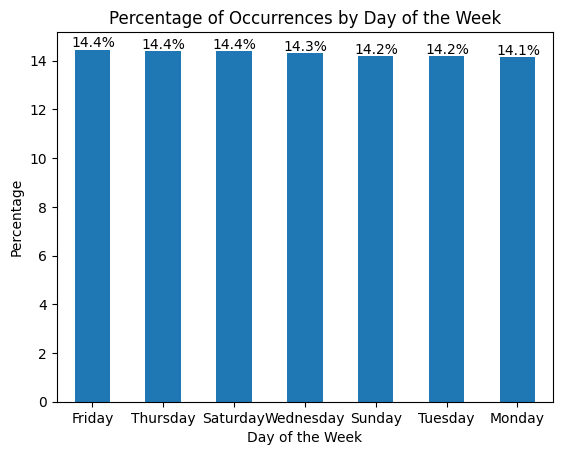

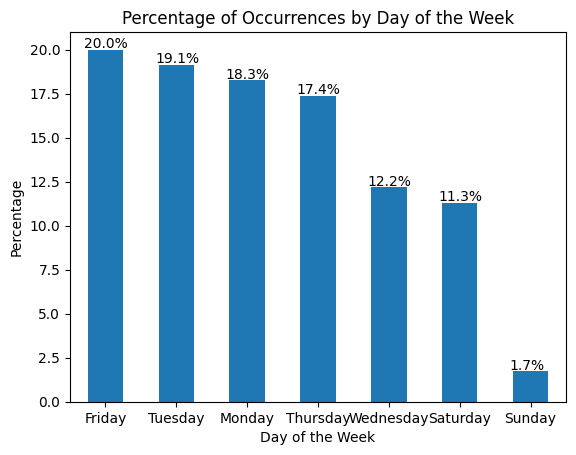

In [53]:
# create a dictionary to map numeric values to day names
day_names = {1: 'Monday', 2: 'Tuesday', 3: 'Wednesday', 4: 'Thursday', 5: 'Friday', 6: 'Saturday', 7: 'Sunday'}

# create a new column with day names
df_aju['DAY_NAME'] = df_aju['DIASEM'].map(day_names)

# count the occurrences of each day name
counts = df_aju['DAY_NAME'].value_counts()

# calculate the percentage of occurrences of each day name
percentages = (counts / counts.sum()) * 100

# create a bar plot of the percentages
ax = percentages.plot(kind='bar', width=0.5)

# set the plot title and axis labels
plt.title('Percentage of Occurrences by Day of the Week')
plt.xlabel('Day of the Week')
plt.ylabel('Percentage')

# set the rotation of the x-axis tick labels
ax.set_xticklabels(ax.get_xticklabels(), rotation=0)

for i, v in enumerate(percentages):
    ax.text(i-0.3, v+0.1, "{:.1f}%".format(v), color='black')

# show the plot
plt.show()

df_f = df_aju[(df_aju.FESTIVO == 1)]

# create a dictionary to map numeric values to day names
day_names = {1: 'Monday', 2: 'Tuesday', 3: 'Wednesday', 4: 'Thursday', 5: 'Friday', 6: 'Saturday', 7: 'Sunday'}

# create a new column with day names
df_f['DAY_NAME'] = df_f['DIASEM'].map(day_names)

# count the occurrences of each day name
counts = df_f['DAY_NAME'].value_counts()

# calculate the percentage of occurrences of each day name
percentages = (counts / counts.sum()) * 100

# create a bar plot of the percentages
ax = percentages.plot(kind='bar', width=0.5)

# set the plot title and axis labels
plt.title('Percentage of Occurrences by Day of the Week')
plt.xlabel('Day of the Week')
plt.ylabel('Percentage')

# set the rotation of the x-axis tick labels
ax.set_xticklabels(ax.get_xticklabels(), rotation=0)

for i, v in enumerate(percentages):
    ax.text(i-0.3, v+0.1, "{:.1f}%".format(v), color='black')

# show the plot
plt.show()

Existe una representación muy parecida de todos los días de la semana en el dataset. Sin embargo, los días festivos no están representados de forma equitativa a lo largo de los días. Muy pocos días festivos suceden el miércoles, sábado o domingo. Esta falta de representación puede causar fallos a la hora de clasificar estos días. 

Para calcular la tasa de fallos según el día de la semana, ejecutamos el siguiente código:

En la tabla a continuación se comparan las métricas obtenidas para cada día de la semana:
| Día                   | Acc TR | Acc TS | Bal Acc TR | Bal Acc TS | F1 TR | F1 TS | Precision TS | Recall TS |
|-----------------------|--------|--------|------------|------------|-------|-------|--------------|-----------|
| **Lunes**             | 89.25% | 98.91% | 91.41%     | 99.43%     | 0.91  | 0.91  | 83%          | 100%      |
| **Martes**            | 93.62% | 98.43% | 93.62%     | 84.60%     | 0.93  | 0.78  | 89%          | 70%       |
| **Miércoles**         | 93.62% | 98.43% | 96.73%     | 82.42%     | 0.97  | 0.75  | 88%          | 65%       |
| **Jueves**            | 97.28% | 98.44% | 97.28%     | 82.51%     | 0.97  | 0.77  | 94%          | 65%       |
| **Viernes**           | 89.81% | 98.80% | 90.06%     | 90.00%     | 0.90  | 0.89  | 100%         | 80%       |
| **Sábado**            | 91.34% | 94.56% | 64.77%     | 50.00%     | 0.46  | 0.00  | 0%           | 0%        |
| **Domingo**           | 100%   | 97.50% | 100%       | 49.36%     | 1.00  | 0.00  | 0%           | 0%        |

Como se puede observar, el modelo en general acierta los festivos entre semana, mientras que no es capaz de identificar aquellos en fin de semana. Esto es lógico por dos razones:
- Como se vio en la gráfica anterior, el número de días destivos que caen en fin de semana es muy bajo, por lo que puede faltar información sobre cómo clasificarlos correctamente.
- El comportamiento de la población es muy similar un fin de semana que un día entre semana. 

Dependiendo de la aplicación, podría interesar no incluir los días de fin de semana en el dataset, ya que se puede asumir que son festivos y probablemente reduciría el ruido de los datos, mejorando los modelos.

**Modelo de producción**

El modelo a elegir para producción depende en gran medida de la aplicación. Lo más importante es que generalice correctamente para que sea capaz de adaptarse a nuevas muestras. Sin embargo, dependiendo de el uso que se vaya a hacer del modelo, puede ser más importante que clasifique correctamente una clase u otra. Entre los diferentes objetivos que pueden existir están acertar el mayor número de veces posible, encontrar todos los días festivos o que todos los días que se clasifiquen como festivos estén correctamente clasificados. Además, según el uso, se puede priorizar un modelo interpretable porque se necesite conocer la lógica detrás de la toma de decisiones.

Aunque no se especifica ninguna aplicación en específico para este proyecto, se puede asumir que el objetivo es entender cómo varía el uso de la electricidad según si el día es festivo o no. La lógica detrás de esta asumpción es que con tan solo mirar un calendario, se puede saber qué día es festivo con mayor precisión de la que va aportar un modelo. Sin embargo, A una compañía eléctrica le puede interesar conocer las diferencias en el consumo de energía en días festivos y no festivos por varias razones:

En primer lugar, el conocimiento de las diferencias en el consumo de energía durante días festivos y no festivos puede ayudar a la compañía a planificar la generación y distribución de energía de manera más efectiva. Por ejemplo, si se espera que el consumo de energía sea menor en días festivos, la compañía puede reducir la producción de energía y ajustar la distribución en consecuencia para evitar el desperdicio de recursos.

En segundo lugar, el conocimiento de las diferencias en el consumo de energía en días festivos y no festivos puede ayudar a la compañía a ajustar sus precios y tarifas para garantizar la rentabilidad y la eficiencia en la producción de energía. Si se espera que el consumo de energía sea menor en días festivos, la compañía puede reducir los precios para atraer a más consumidores y mantener la demanda de energía.

En tercer lugar, el conocimiento de las diferencias en el consumo de energía en días festivos y no festivos puede ayudar a la compañía a optimizar el uso de sus recursos, lo que puede ser beneficioso tanto desde una perspectiva económica como medioambiental. Si se espera que el consumo de energía sea menor en días festivos, la compañía puede programar el mantenimiento y la reparación de equipos y maquinarias para evitar interrupciones en la producción de energía en días de alta demanda.

En conclusión, conocer las diferencias en el consumo de energía en días festivos y no festivos puede proporcionar a una compañía eléctrica información valiosa para planificar, ajustar los precios y tarifas, optimizar el uso de los recursos y mejorar su eficiencia y rentabilidad en la producción y distribución de energía, por lo que la interpretabilidad del modelo será un factor clave a tener en cuenta a la hora de elegir cuál poner en producción.

Puesto que en los diferentes modelos se ha observado cómo las variables más importantes coincidían y era sencilllo entender por qué resultaban esas, se puede escoger casi cualquier modelo siguiendo el criterio de la interpretabilidad (aunque el Simple Tree aporta más información que la importancia de cada variable). Por lo tanto, se elegirá el modelo con mejores métricas.

La elección resulta sencilla porque el modelo de Bagged Trees destaca en todas las métricas. En primer lugar, es el modelo con menor diferencia entre los errores en training y en test, tanto en Accuracy (diferencia de 1 pp) como en Balanced Accuracy (diferencia de 9.88 pp) y F1-score (diferencia de 0.14). Además, es el modelo con mejores puntuaciones en test (Accuracy 99%, Balanced Accuracy 84.68% y F1-score 0.8). Tan solo se elegiría el Simple Tree si por límites de tiempo o espacio se necesitase un modelo más sencillo.

Por lo tanto, el modelo que se elegiría para llevar a producción sería el Bagged Tree.

---
### 2. VALIDACIÓN FINAL DE LOS MODELOS CON EL DATASET VAL_DATOS_DEM_C3

Se correpondería como si los todos los modelos creados anteriormente se ponen en producción el 1 enero de 2022 y se tienen estimando la festividad durante todo el año para ver qué tal funcionan.

Recuerda, no se debería ver ningún resultado sobre este dataset hasta haber completado todos los apartados anteriores.

Carga datos de validación

In [29]:
#--------------------------NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|

df_val = pd.read_csv('VAL_DATOS_DEM_C3.csv')

# parseamos la fecha (cadena) para que sea un datetime con formato dd/mm/yyyy 
# esta variable NO se puede utilizar como entrada en los modelos
df_val.FECHA = pd.to_datetime(df_val.FECHA, format='%d/%m/%Y') 
s=df_val.loc[:,'FECHA']
df_val['FECHA'] =  s.dt.date

# eliminamos las variables que no se pueden usar como entradas en los modelos
del df_val['ANNO']
del df_val['DIA']

print('Tamaño de df_val con los datos cargados:', df_val.shape)
print('Dataframe con todos los datos leidos (filas: días, columnas: variables):')
print(df_val)

Tamaño de df_val con los datos cargados: (357, 30)
Dataframe con todos los datos leidos (filas: días, columnas: variables):
          FECHA      CR00      CR01      CR02      CR03      CR04      CR05  \
0    2022-01-01  0.038935  0.037313  0.035291  0.033673  0.032924  0.033235   
1    2022-01-02  0.035271  0.033313  0.031889  0.031411  0.031302  0.031975   
2    2022-01-03  0.033756  0.032003  0.030669  0.030051  0.030199  0.031280   
3    2022-01-04  0.034484  0.032505  0.031375  0.030540  0.030431  0.031324   
4    2022-01-05  0.034669  0.032213  0.030933  0.030382  0.030527  0.031611   
..          ...       ...       ...       ...       ...       ...       ...   
352  2022-12-27  0.033279  0.031139  0.029907  0.029433  0.029757  0.030972   
353  2022-12-28  0.033250  0.031186  0.029934  0.029447  0.029821  0.030942   
354  2022-12-29  0.033718  0.031695  0.030290  0.029717  0.030014  0.031075   
355  2022-12-30  0.033673  0.031494  0.030124  0.029639  0.029629  0.030732   
356  20

#### 2.1. Compara los errores obtenidos en validación con los observados previamente en ajuste/test
- Una vez terminados todos los ajustes de los modelos en el apartado 1.1., ejecuta los mismos para estimar si los días de 2022 son festivos o no (conjunto df_val)
- Muestra los resultados de clasificación obtenidos en el nuevo dataset (accuray y tablas de confusión de cada modelo)
- Discute si los errores obtenidos son coherentes con lo que se esperaba como resultado de los análisis previos para estimar la capacidad de generalización de cada uno de los modelos

In [30]:
#--------------------------NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|


#### 2.2. Análisis de los días peor clasificados
- Indica en una tabla la lista de los días que se han clasificado incorrectamente por cada uno de los modelos considerados
- Comenta las posibles diferencias y semejanzas, intentando buscar una justificación de por qué ha ocurrido el error de clasificación
- Muestra gráficamente los perfiles de 24 horas de los 3 días más difíciles de clasificar para los modelos, comparándolos con lo esperado según el día de la semana correspondiente

In [31]:
#--------------------------NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|


# Anexo
## Tasa de error según el día de la semana

In [20]:
def calculate_metrics(estimator, X_train, X_test, y_train, y_test):
    clf = estimator
    y_train_pred = clf.predict(X_train[INPUTS_BT]).tolist()
    y_test_pred = clf.predict(X_test[INPUTS_BT]).tolist()

    # main metrics
    acc_tr = metrics.accuracy_score(y_train,y_train_pred)
    acc_ts = metrics.accuracy_score(y_test,y_test_pred)

    acc_bal_tr = metrics.balanced_accuracy_score(y_train,y_train_pred)
    acc_bal_ts = metrics.balanced_accuracy_score(y_test,y_test_pred)

    dfacc =  pd.DataFrame([[acc_tr, acc_ts], [acc_bal_tr, acc_bal_ts]], index= ['Accuracy', 'Balanced accuracy'],  columns=['TR', 'TS'])
    print(dfacc)

    print('\nMETRICS TRAINING:')
    CT.confusion_matrix(y_train, y_train_pred, labels=[1,0])
    print('\nMETRICS TEST SET:')
    CT.confusion_matrix(y_test, y_test_pred, labels=[1,0])

**Lunes**

In [28]:
X_train_l = X_train[X_train.DIASEM == 1]
X_test_l = X_test[X_test.DIASEM == 1]
y_train_l = y_train[y_train.index.isin(X_train_l.index)]
y_test_l = y_test[y_test.index.isin(X_test_l.index)]
loaded_bt = pickle.load(open("./models/bagged_tree_v2.pickle", "rb"))
calculate_metrics(loaded_bt, X_train_l[INPUTS_BT], X_test_l[INPUTS_BT], y_train_l, y_test_l)

                         TR        TS
Accuracy           0.892500  0.989130
Balanced accuracy  0.914172  0.994253

METRICS TRAINING:
Confusion Matrix and Statistics
	   Prediction
 Reference   1   0
         1 415  86
         0   0 299

Accuracy: 0.89
No Information Rate: 0.5
P-Value [Acc > NIR]: 0.0
Kappa: 0.78
Mcnemar's Test P-Value: 0.0
Sensitivity: 1.0
Specificity: 0.83
Precision: 1.0
Recall: 0.83
Prevalence: 0.37
Detection Rate: 0.37
Detection prevalence: 0.48
Balanced accuracy: 0.91
F1 Score: 0.91
Positive label: 1

METRICS TEST SET:
Confusion Matrix and Statistics
	   Prediction
 Reference  1  0
         1  5  0
         0  1 86

Accuracy: 0.99
No Information Rate: 0.89
P-Value [Acc > NIR]: 0.04
Kappa: 0.9
Mcnemar's Test P-Value: 1.0
Sensitivity: 0.99
Specificity: 1.0
Precision: 0.83
Recall: 1.0
Prevalence: 0.95
Detection Rate: 0.93
Detection prevalence: 0.93
Balanced accuracy: 0.99
F1 Score: 0.91
Positive label: 1


**Martes**

In [29]:
X_train_l = X_train[X_train.DIASEM == 2]
X_test_l = X_test[X_test.DIASEM == 2]
y_train_l = y_train[y_train.index.isin(X_train_l.index)]
y_test_l = y_test[y_test.index.isin(X_test_l.index)]
calculate_metrics(loaded_bt, X_train_l[INPUTS_BT], X_test_l[INPUTS_BT], y_train_l, y_test_l)

                         TR   TS
Accuracy           0.980609  1.0
Balanced accuracy  0.982927  1.0

METRICS TRAINING:
Confusion Matrix and Statistics
	   Prediction
 Reference   1   0
         1 396  14
         0   0 312

Accuracy: 0.98
No Information Rate: 0.51
P-Value [Acc > NIR]: 0.0
Kappa: 0.96
Mcnemar's Test P-Value: 0.0
Sensitivity: 1.0
Specificity: 0.97
Precision: 1.0
Recall: 0.97
Prevalence: 0.43
Detection Rate: 0.43
Detection prevalence: 0.45
Balanced accuracy: 0.98
F1 Score: 0.98
Positive label: 1

METRICS TEST SET:
Confusion Matrix and Statistics
	   Prediction
 Reference  1  0
         1  4  0
         0  0 74

Accuracy: 1.0
No Information Rate: 0.9
P-Value [Acc > NIR]: 0.02
Kappa: 1.0
Mcnemar's Test P-Value: 1.0
Sensitivity: 1.0
Specificity: 1.0
Precision: 1.0
Recall: 1.0
Prevalence: 0.95
Detection Rate: 0.95
Detection prevalence: 0.95
Balanced accuracy: 1.0
F1 Score: 1.0
Positive label: 1


**Miércoles**

In [30]:
X_train_l = X_train[X_train.DIASEM == 3]
X_test_l = X_test[X_test.DIASEM == 3]
y_train_l = y_train[y_train.index.isin(X_train_l.index)]
y_test_l = y_test[y_test.index.isin(X_test_l.index)]
calculate_metrics(loaded_bt, X_train_l[INPUTS_BT], X_test_l[INPUTS_BT], y_train_l, y_test_l)

                         TR   TS
Accuracy           0.971037  1.0
Balanced accuracy  0.970948  1.0

METRICS TRAINING:
Confusion Matrix and Statistics
	   Prediction
 Reference   1   0
         1 308  19
         0   0 329

Accuracy: 0.97
No Information Rate: 0.5
P-Value [Acc > NIR]: 0.0
Kappa: 0.94
Mcnemar's Test P-Value: 0.0
Sensitivity: 1.0
Specificity: 0.94
Precision: 1.0
Recall: 0.94
Prevalence: 0.5
Detection Rate: 0.5
Detection prevalence: 0.53
Balanced accuracy: 0.97
F1 Score: 0.97
Positive label: 1

METRICS TEST SET:
Confusion Matrix and Statistics
	   Prediction
 Reference  1  0
         1  3  0
         0  0 69

Accuracy: 1.0
No Information Rate: 0.92
P-Value [Acc > NIR]: 0.05
Kappa: 1.0
Mcnemar's Test P-Value: 1.0
Sensitivity: 1.0
Specificity: 1.0
Precision: 1.0
Recall: 1.0
Prevalence: 0.96
Detection Rate: 0.96
Detection prevalence: 0.96
Balanced accuracy: 1.0
F1 Score: 1.0
Positive label: 1


**Jueves**

In [31]:
X_train_l = X_train[X_train.DIASEM == 4]
X_test_l = X_test[X_test.DIASEM == 4]
y_train_l = y_train[y_train.index.isin(X_train_l.index)]
y_test_l = y_test[y_test.index.isin(X_test_l.index)]
calculate_metrics(loaded_bt, X_train_l[INPUTS_BT], X_test_l[INPUTS_BT], y_train_l, y_test_l)

                         TR   TS
Accuracy           0.928817  1.0
Balanced accuracy  0.944144  1.0

METRICS TRAINING:
Confusion Matrix and Statistics
	   Prediction
 Reference   1   0
         1 493  62
         0   0 316

Accuracy: 0.93
No Information Rate: 0.52
P-Value [Acc > NIR]: 0.0
Kappa: 0.85
Mcnemar's Test P-Value: 0.0
Sensitivity: 1.0
Specificity: 0.89
Precision: 1.0
Recall: 0.89
Prevalence: 0.36
Detection Rate: 0.36
Detection prevalence: 0.43
Balanced accuracy: 0.94
F1 Score: 0.94
Positive label: 1

METRICS TEST SET:
Confusion Matrix and Statistics
	   Prediction
 Reference  1  0
         1  0  0
         0  0 78

Accuracy: 1.0
No Information Rate: 1.0
P-Value [Acc > NIR]: 1.0
Kappa: nan
Mcnemar's Test P-Value: 1.0
Precision: 0.5
Recall: 0.5
Balanced accuracy: 1.0
F1 Score: 0.5
Positive label: 1


**Viernes**

In [32]:
X_train_l = X_train[X_train.DIASEM == 5]
X_test_l = X_test[X_test.DIASEM == 5]
y_train_l = y_train[y_train.index.isin(X_train_l.index)]
y_test_l = y_test[y_test.index.isin(X_test_l.index)]
calculate_metrics(loaded_bt, X_train_l[INPUTS_BT], X_test_l[INPUTS_BT], y_train_l, y_test_l)

                         TR        TS
Accuracy           0.898108  0.988095
Balanced accuracy  0.906166  0.900000

METRICS TRAINING:
Confusion Matrix and Statistics
	   Prediction
 Reference   1   0
         1 303  70
         0   0 314

Accuracy: 0.9
No Information Rate: 0.49
P-Value [Acc > NIR]: 0.0
Kappa: 0.8
Mcnemar's Test P-Value: 0.0
Sensitivity: 1.0
Specificity: 0.81
Precision: 1.0
Recall: 0.81
Prevalence: 0.46
Detection Rate: 0.46
Detection prevalence: 0.56
Balanced accuracy: 0.91
F1 Score: 0.9
Positive label: 1

METRICS TEST SET:
Confusion Matrix and Statistics
	   Prediction
 Reference  1  0
         1  4  1
         0  0 79

Accuracy: 0.99
No Information Rate: 0.9
P-Value [Acc > NIR]: 0.04
Kappa: 0.88
Mcnemar's Test P-Value: 1.0
Sensitivity: 1.0
Specificity: 0.8
Precision: 1.0
Recall: 0.8
Prevalence: 0.94
Detection Rate: 0.94
Detection prevalence: 0.95
Balanced accuracy: 0.9
F1 Score: 0.89
Positive label: 1


**Sábado**

In [33]:
X_train_l = X_train[X_train.DIASEM == 6]
X_test_l = X_test[X_test.DIASEM == 6]
y_train_l = y_train[y_train.index.isin(X_train_l.index)]
y_test_l = y_test[y_test.index.isin(X_test_l.index)]
calculate_metrics(loaded_bt, X_train_l[INPUTS_BT], X_test_l[INPUTS_BT], y_train_l, y_test_l)

                         TR        TS
Accuracy           0.913408  0.945652
Balanced accuracy  0.647727  0.500000

METRICS TRAINING:
Confusion Matrix and Statistics
	   Prediction
 Reference  1   0
         1 13  31
         0  0 314

Accuracy: 0.91
No Information Rate: 0.85
P-Value [Acc > NIR]: 0.02
Kappa: 0.42
Mcnemar's Test P-Value: 0.0
Sensitivity: 1.0
Specificity: 0.3
Precision: 1.0
Recall: 0.3
Prevalence: 0.88
Detection Rate: 0.88
Detection prevalence: 0.96
Balanced accuracy: 0.65
F1 Score: 0.46
Positive label: 1

METRICS TEST SET:
Confusion Matrix and Statistics
	   Prediction
 Reference  1  0
         1  0  5
         0  0 87

Accuracy: 0.95
No Information Rate: 0.95
P-Value [Acc > NIR]: 0.62
Kappa: 0.0
Mcnemar's Test P-Value: 0.06
Sensitivity: 1.0
Specificity: 0.0
Precision: 0.0
Recall: 0.0
Prevalence: 0.95
Detection Rate: 0.95
Detection prevalence: 1.0
Balanced accuracy: 0.5
F1 Score: 0.0
Positive label: 1


**Domingo**

In [34]:
X_train_l = X_train[X_train.DIASEM == 7]
X_test_l = X_test[X_test.DIASEM == 7]
y_train_l = y_train[y_train.index.isin(X_train_l.index)]
y_test_l = y_test[y_test.index.isin(X_test_l.index)]
calculate_metrics(loaded_bt, X_train_l[INPUTS_BT], X_test_l[INPUTS_BT], y_train_l, y_test_l)

                    TR        TS
Accuracy           1.0  0.975000
Balanced accuracy  1.0  0.493671

METRICS TRAINING:
Confusion Matrix and Statistics
	   Prediction
 Reference  1   0
         1  1   0
         0  0 327

Accuracy: 1.0
No Information Rate: 0.99
P-Value [Acc > NIR]: 0.37
Kappa: 1.0
Mcnemar's Test P-Value: 1.0
Sensitivity: 1.0
Specificity: 1.0
Precision: 1.0
Recall: 1.0
Prevalence: 1.0
Detection Rate: 1.0
Detection prevalence: 1.0
Balanced accuracy: 1.0
F1 Score: 1.0
Positive label: 1

METRICS TEST SET:
Confusion Matrix and Statistics
	   Prediction
 Reference  1  0
         1  0  1
         0  1 78

Accuracy: 0.98
No Information Rate: 0.98
P-Value [Acc > NIR]: 0.92
Kappa: -0.01
Mcnemar's Test P-Value: 1.0
Sensitivity: 0.99
Specificity: 0.0
Precision: 0.0
Recall: 0.0
Prevalence: 0.99
Detection Rate: 0.98
Detection prevalence: 0.99
Balanced accuracy: 0.49
F1 Score: 0.0
Positive label: 1
